Technological Institute of the Philippines | Quezon City - Computer Engineering
--- | ---
Course Code: | CPE 019
Code Title: | Emerging Technologies in CpE 2
2nd Semester | SY 2023-2024
<hr> | <hr>
<u>**ASSIGNMENT 9.1** | **Convolutional Neural Network**
**Name/s** |Escalicas, Peter Allen
**Section** | CPE32S1
**Date Performed**: | 04/26/2024
**Date Submitted**: | 04/27/2024
**Instructor**: | Engr. Roman


**Dataset Link** = https://archive.ics.uci.edu/dataset/908/realwaste

**Dataset** = RealWaste is an image classification dataset of waste items across 9 major material types, collected within an authentic landfill environment.

**Problem Being Addressed** = The problem being addressed in the Real Waste dataset is to determine how well Convolutional Neural Networks (CNNs) can classify waste materials based on images captured in a real-world landfill environment.

# Importing Libraries and Dataset


In [6]:
import os
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

In [7]:
# Mount Google Drive if you're using Google Colab
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [8]:
# Set your data directory
data_dir = '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste'

# Define image dimensions and batch size
img_width, img_height = 150, 150
batch_size = 32

In [9]:
data_dir_list = os.listdir(data_dir)
print("List of directories in dataset:", data_dir_list)

#count
file_count = len(os.listdir(data_dir))
print("Total number of files in dataset:", file_count)

List of directories in dataset: ['Metal', 'Plastic', 'Textile Trash', 'Miscellaneous Trash', 'Paper', 'Glass', 'Vegetation', 'Cardboard', 'Food Organics']
Total number of files in dataset: 9


In [10]:
#store file paths
file_paths = []
labels = []

#iteration
for class_name in os.listdir(data_dir):
    class_dir = os.path.join(data_dir, class_name)
    for file_name in os.listdir(class_dir):
        file_path = os.path.join(class_name, file_name)
        file_paths.append(file_path)
        labels.append(class_name)

# Task 1 Baseline CNN

In [16]:
# Create data generators for training, validation, and testing
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)
train_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training')

validation_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation')

# Build the CNN model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(img_width, img_height, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(9, activation='softmax')
])


Found 2434 images belonging to 9 classes.
Found 605 images belonging to 9 classes.


In [17]:
# Compile the model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)

# Evaluate the model
test_loss, test_acc = model.evaluate(validation_generator, verbose=2)
print("Test Accuracy:", test_acc)

Epoch 1/10
76/76 [==============================] - 210s 3s/step - loss: 1.9933 - accuracy: 0.2298 - val_loss: 1.7472 - val_accuracy: 0.2986
Epoch 2/10
76/76 [==============================] - 209s 3s/step - loss: 1.8314 - accuracy: 0.2694 - val_loss: 1.5297 - val_accuracy: 0.4340
Epoch 3/10
76/76 [==============================] - 218s 3s/step - loss: 1.5968 - accuracy: 0.3805 - val_loss: 1.4723 - val_accuracy: 0.4358
Epoch 4/10
76/76 [==============================] - 218s 3s/step - loss: 1.4833 - accuracy: 0.4163 - val_loss: 1.3738 - val_accuracy: 0.4340
Epoch 5/10
76/76 [==============================] - 206s 3s/step - loss: 1.4109 - accuracy: 0.4580 - val_loss: 1.3796 - val_accuracy: 0.4653
Epoch 6/10
76/76 [==============================] - 208s 3s/step - loss: 1.2694 - accuracy: 0.5308 - val_loss: 1.3359 - val_accuracy: 0.4722
Epoch 7/10
76/76 [==============================] - 207s 3s/step - loss: 1.1854 - accuracy: 0.5520 - val_loss: 1.2090 - val_accuracy: 0.5226
Epoch 8/10
76

# Task 2 Image Augmentation


Found 2425 images belonging to 9 classes.
Found 605 images belonging to 9 classes.


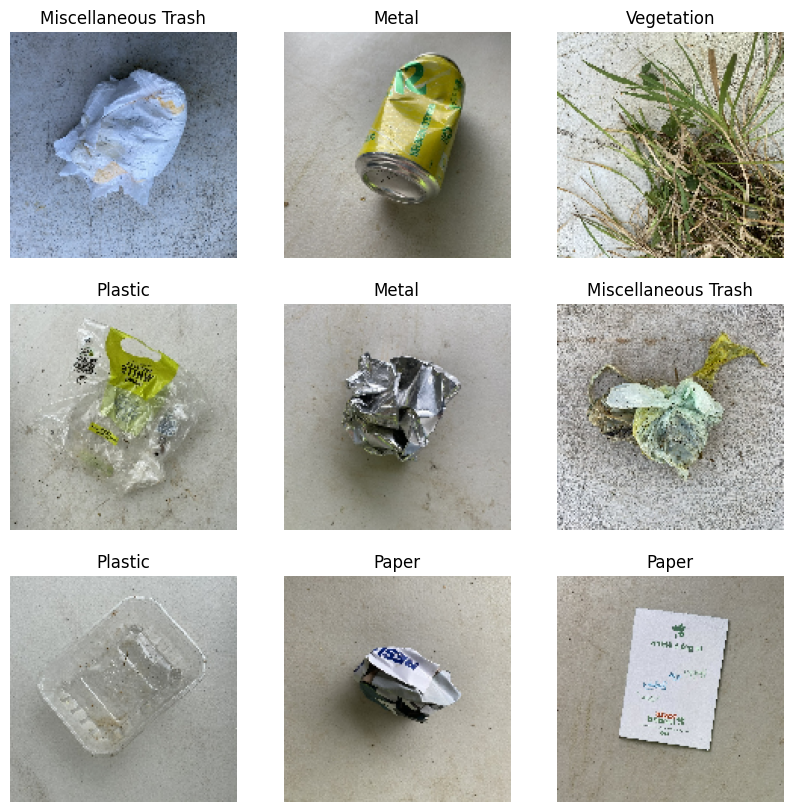

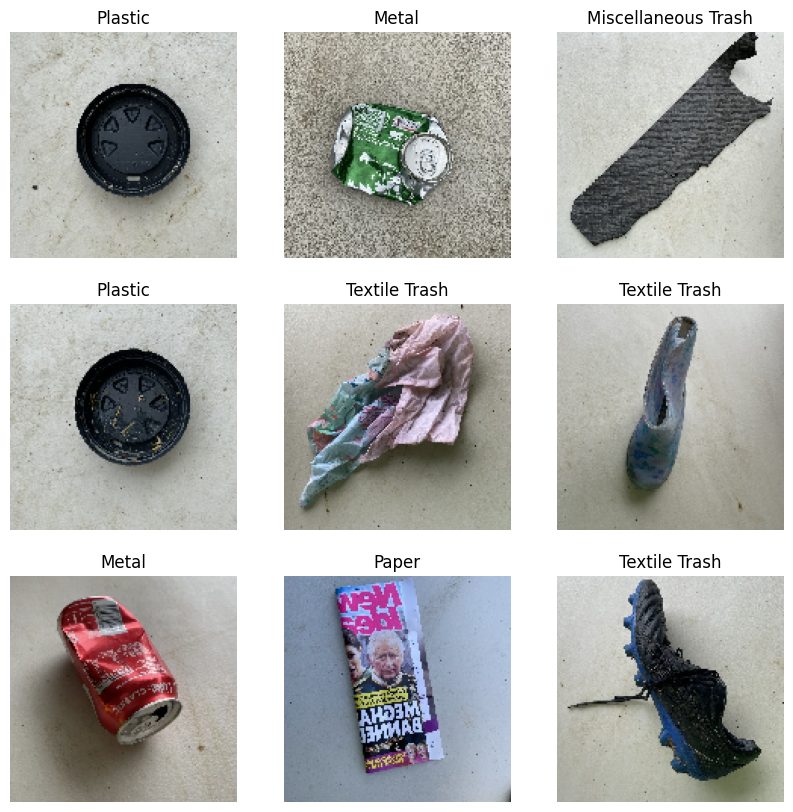

In [ ]:
# Create data generators for training, validation, and testing with image augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=0,
    width_shift_range=0,
    height_shift_range=0,
    shear_range=0,
    zoom_range=0,
    horizontal_flip=True,
    validation_split=0.2
)

train_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

# Plot augmented images
categories = train_generator.class_indices

def plot_images(generator, num_images=9):
    plt.figure(figsize=(10, 10))
    for i in range(num_images):
        batch = generator.next()
        image = batch[0][i]  # Retrieve the original image without the filters
        label_index = batch[1][i].argmax()
        label = list(categories.keys())[list(categories.values()).index(label_index)]
        plt.subplot(3, 3, i+1)
        plt.imshow(image)
        plt.title(label)
        plt.axis('off')
    plt.show()

# Training images with labels
plot_images(train_generator)

# Validation images with labels
plot_images(validation_generator)

# Task 3 Perform feature standardization


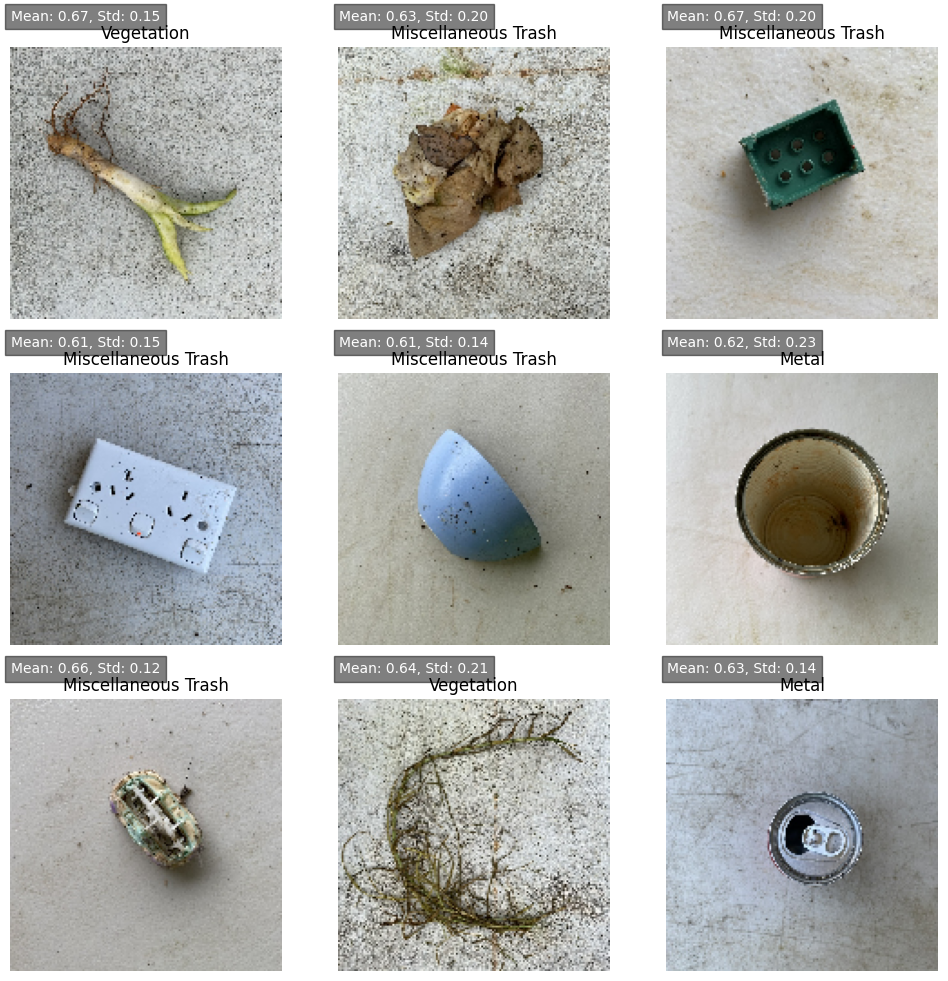

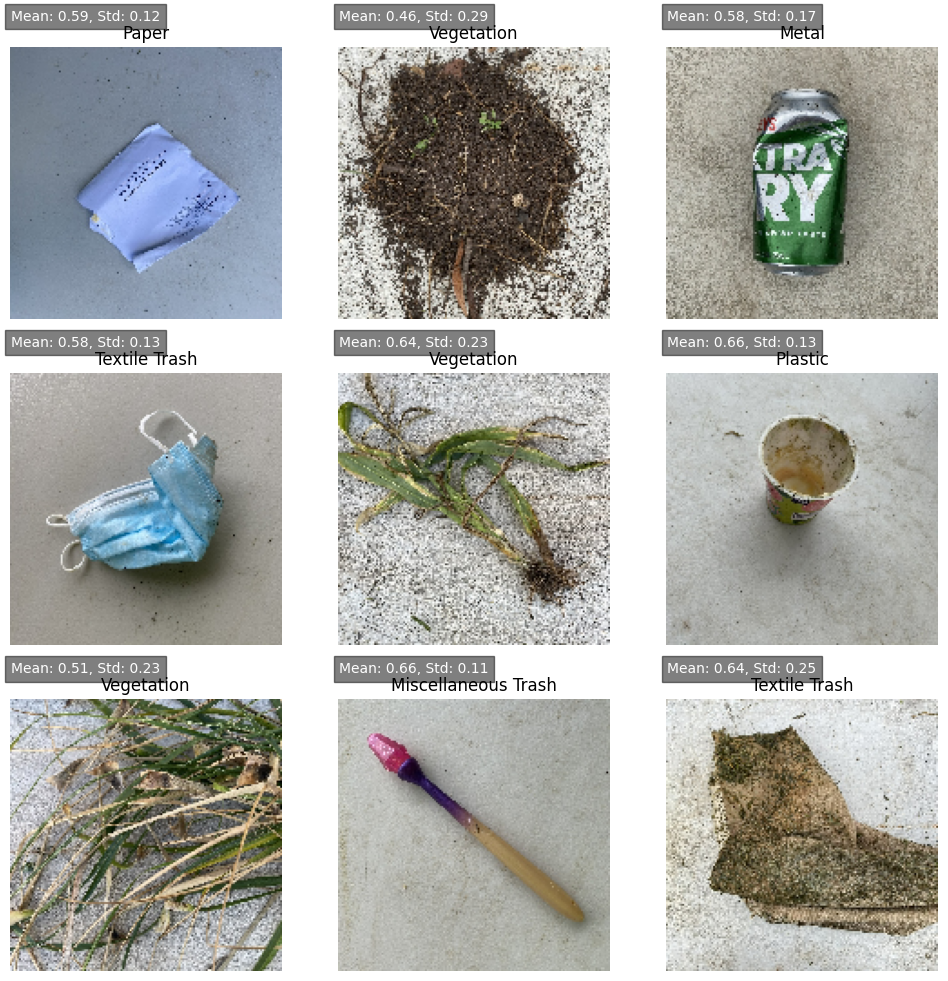

In [ ]:
# Create data generators for training, validation, and testing with image augmentation and feature standardization
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=0,
    width_shift_range=0,
    height_shift_range=0,
    shear_range=0,
    zoom_range=0,
    horizontal_flip=True,
    validation_split=0.2,
    featurewise_center=True,             # Apply feature-wise centering
    featurewise_std_normalization=True   # Apply feature-wise standardization
)

# Plot images with feature standardization statistics
categories = train_generator.class_indices

def plot_images(generator, num_images=9):
    plt.figure(figsize=(12, 12))
    for i in range(num_images):
        batch = generator.next()
        image = batch[0][0]
        label_index = batch[1][0].argmax()
        label = list(categories.keys())[list(categories.values()).index(label_index)]
        mean_pixel_value = np.mean(batch[0][0])
        std_pixel_value = np.std(batch[0][0])
        plt.subplot(3, 3, i+1)
        plt.imshow(image)
        plt.title(label)
        plt.text(0, -15, f"Mean: {mean_pixel_value:.2f}, Std: {std_pixel_value:.2f}", fontsize=10, color='white', bbox=dict(facecolor='black', alpha=0.5))
        plt.axis('off')
    plt.show()

# Training images with labels and feature standardization statistics
plot_images(train_generator)

# Validation images with labels and feature standardization statistics
plot_images(validation_generator)

# Task 4 Perform ZCA whitening of your images

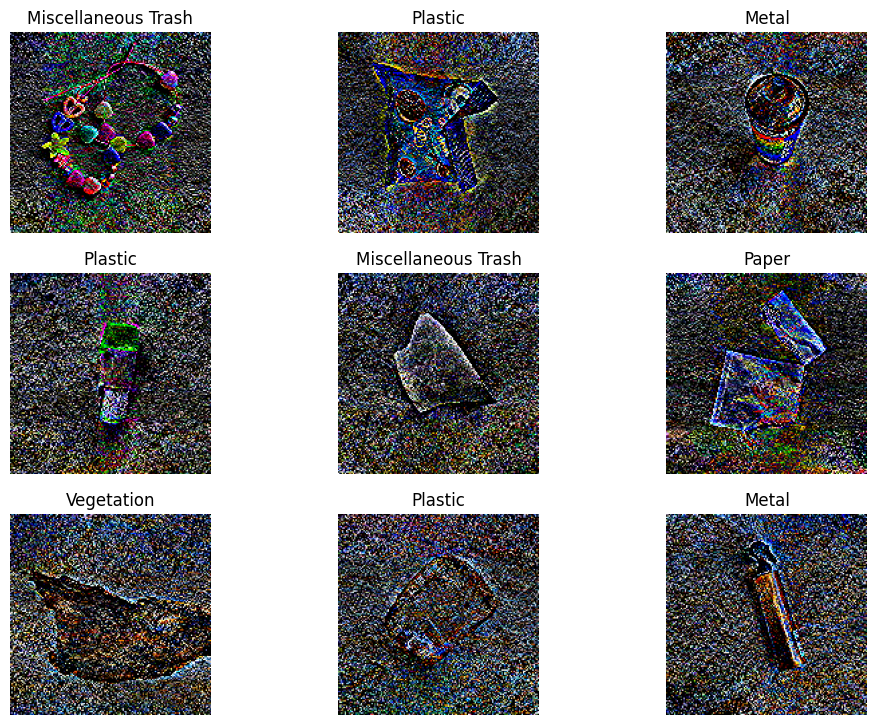

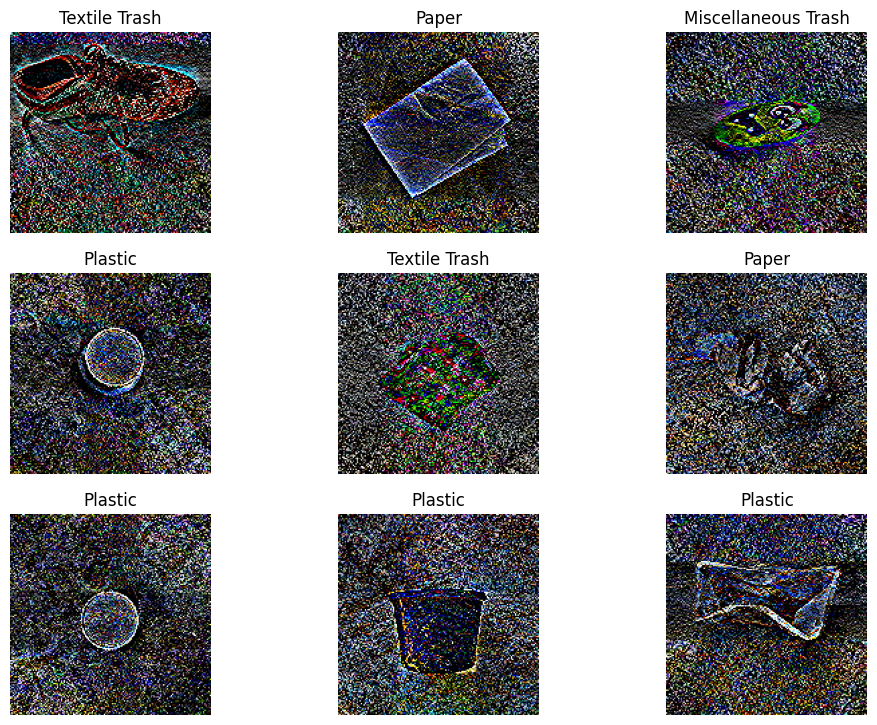

In [ ]:
# Create data generators for training, validation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    validation_split=0.2,
    featurewise_center=True,
    featurewise_std_normalization=True,
    zca_whitening=True                   # Apply ZCA whitening
)

# Plot images with ZCA whitening
categories = train_generator.class_indices

def zca_whitening(images):
    images_flat = images.reshape(images.shape[0], -1)
    cov_matrix = np.dot(images_flat.T, images_flat) / images_flat.shape[0]
    U, S, V = np.linalg.svd(cov_matrix)
    epsilon = 1e-5
    zca_matrix = np.dot(U, np.dot(np.diag(1.0 / np.sqrt(S + epsilon)), U.T))
    whitened_images_flat = np.dot(images_flat, zca_matrix.T)
    whitened_images = whitened_images_flat.reshape(images.shape)
    return whitened_images

def plot_images_with_whitening(generator, num_images=9):
    plt.figure(figsize=(12, 12))
    num_rows = num_images // 3 + 1
    for i in range(num_images):
        batch = generator.next()
        images = batch[0]
        labels = batch[1]
        for j in range(images.shape[0]):
            if i * num_images + j >= num_images:
                break
            image = images[j]
            label_index = labels[j].argmax()
            label = list(categories.keys())[list(categories.values()).index(label_index)]
            # Apply ZCA whitening
            whitened_image = zca_whitening(image)
            # Clip pixel values to valid range
            whitened_image = np.clip(whitened_image, 0, 1)
            plt.subplot(num_rows, 3, i * 3 + j + 1)
            plt.imshow(whitened_image)
            plt.title(label)
            plt.axis('off')
    plt.show()

# Training images with labels and ZCA whitening
plot_images_with_whitening(train_generator)

# Validation images with labels and ZCA whitening
plot_images_with_whitening(validation_generator)

# Task 5 Augment data with random rotations

Found 2425 images belonging to 9 classes.
Found 605 images belonging to 9 classes.


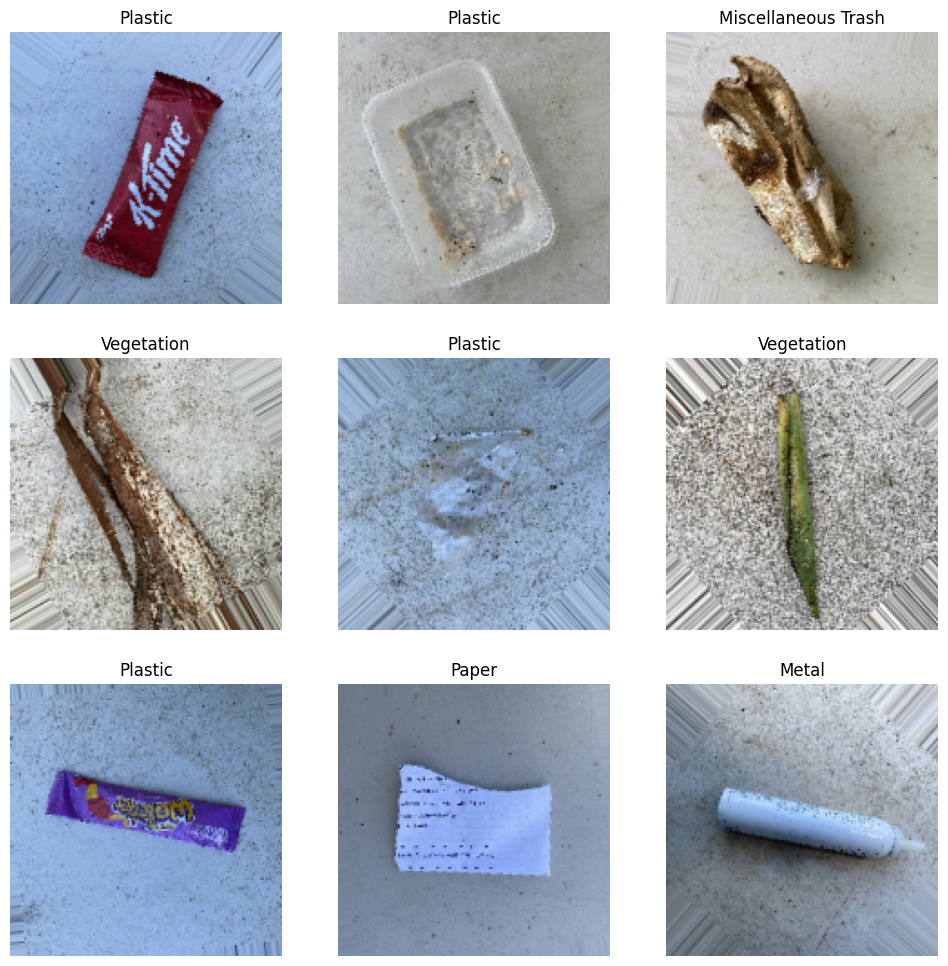

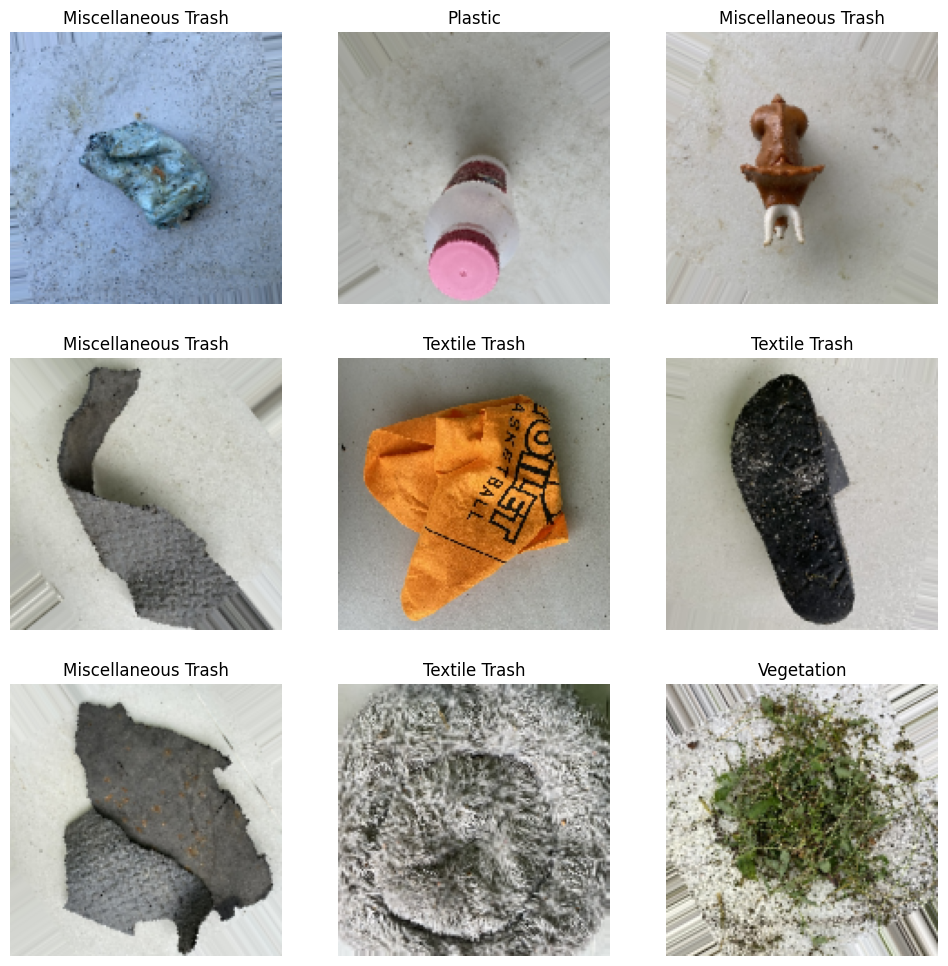

In [ ]:
# Create data generators
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=90,               # Random rotations up to 40 degrees
    validation_split=0.2
)

train_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)


def plot_images_with_rotation(generator, num_images=9, rotation_range=40):
    plt.figure(figsize=(12, 12))
    for i in range(num_images):
        batch = generator.next()
        image = batch[0][0]
        label_index = batch[1][0].argmax()
        label = list(categories.keys())[list(categories.values()).index(label_index)]
        mean_pixel_value = np.mean(batch[0][0])
        std_pixel_value = np.std(batch[0][0])

        #apply rotation
        rotated_image = np.rot90(image, k=np.random.randint(1, 4))

        plt.subplot(3, 3, i+1)
        plt.imshow(rotated_image)
        plt.title(label)
        plt.axis('off')
    plt.show()

plot_images_with_rotation(train_generator)
plot_images_with_rotation(validation_generator)

# Task 5 Augment data with random shifts

Found 2425 images belonging to 9 classes.
Found 605 images belonging to 9 classes.


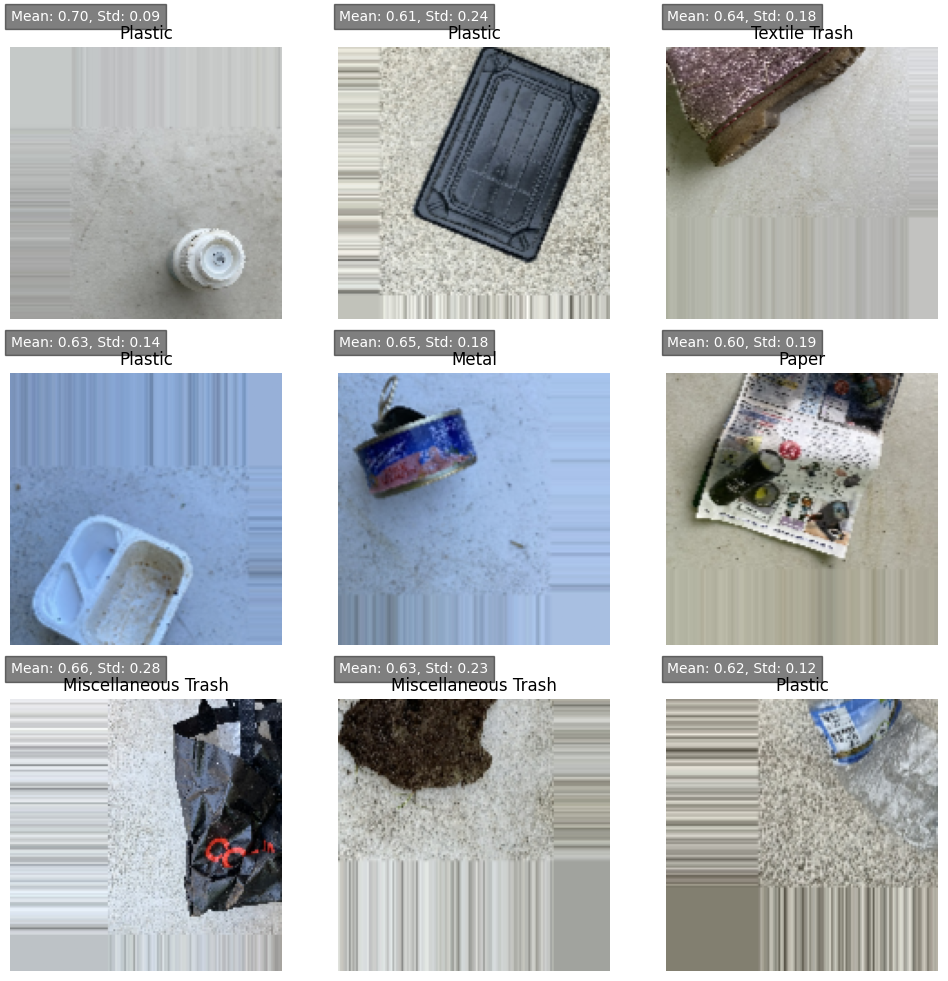

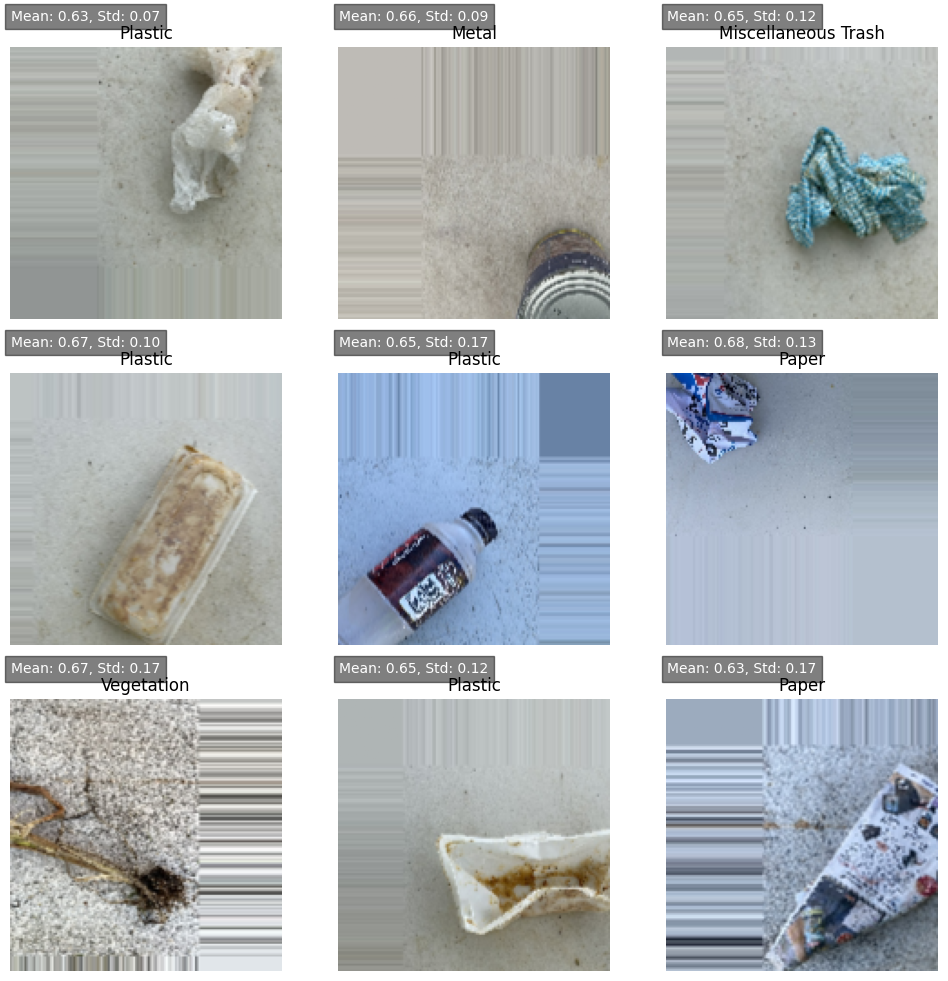

In [ ]:
# Create data generators
train_datagen = ImageDataGenerator(
    rescale=1./255,
    width_shift_range=0.4,
    height_shift_range=0.4,
    validation_split=0.2
)

train_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)


# Plot images
categories = train_generator.class_indices

def plot_images(generator, num_images=9):
    plt.figure(figsize=(12, 12))
    for i in range(num_images):
        batch = generator.next()
        image = batch[0][0]
        label_index = batch[1][0].argmax()
        label = list(categories.keys())[list(categories.values()).index(label_index)]
        mean_pixel_value = np.mean(batch[0][0])
        std_pixel_value = np.std(batch[0][0])
        plt.subplot(3, 3, i+1)
        plt.imshow(image)
        plt.title(label)
        plt.text(0, -15, f"Mean: {mean_pixel_value:.2f}, Std: {std_pixel_value:.2f}", fontsize=10, color='white', bbox=dict(facecolor='black', alpha=0.5))
        plt.axis('off')
    plt.show()

# Training images with labels
plot_images(train_generator)

# Validation images with labels
plot_images(validation_generator)

# Task 5 Augment data with random flip

Found 2425 images belonging to 9 classes.
Found 605 images belonging to 9 classes.


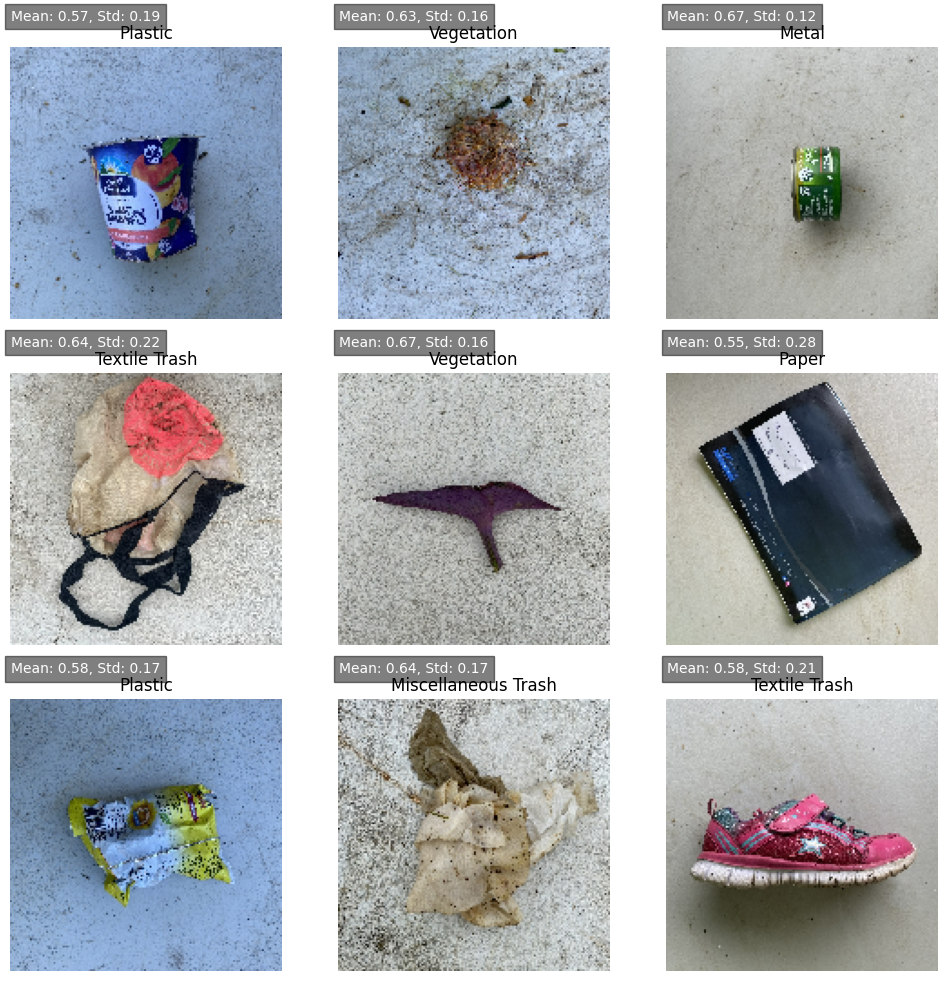

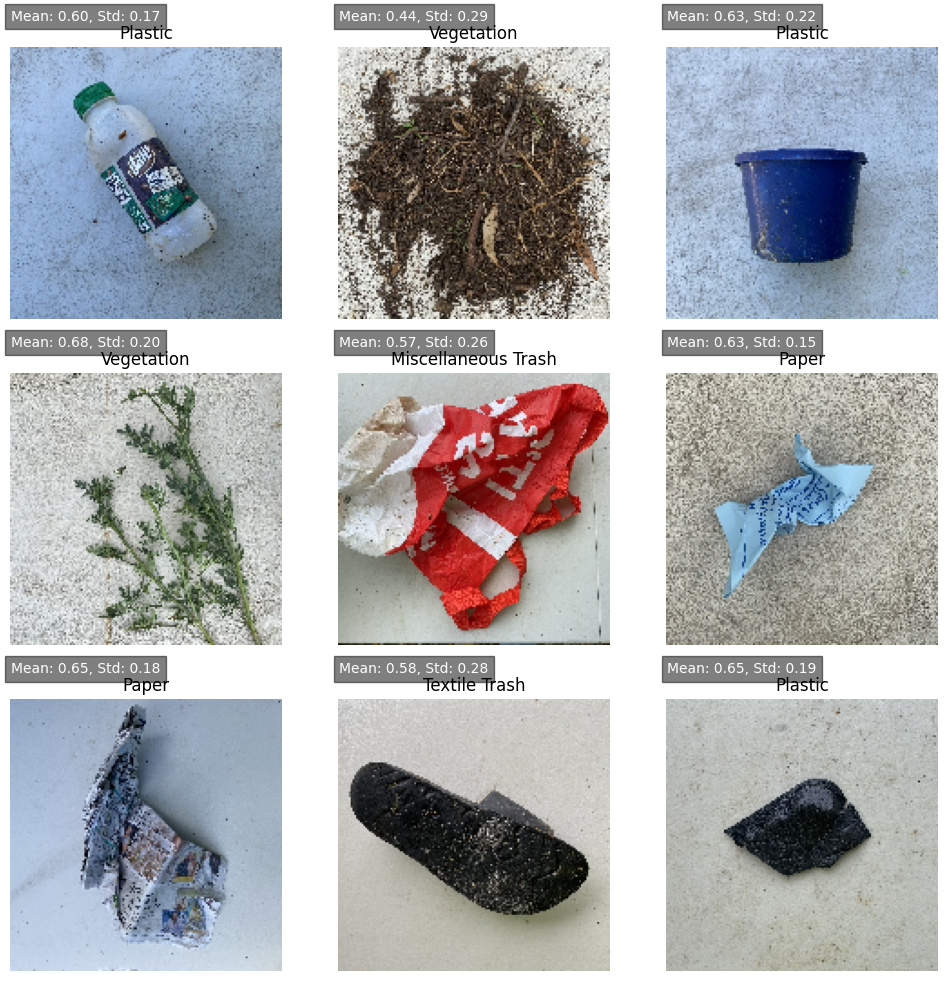

In [ ]:
# Create data generators for training, validation, and testing with image augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    horizontal_flip=True,
    validation_split=0.2
)

train_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)


# Plot images
categories = train_generator.class_indices

def plot_images(generator, num_images=9):
    plt.figure(figsize=(12, 12))
    for i in range(num_images):
        batch = generator.next()
        images = batch[0]
        labels = batch[1]
        for j in range(images.shape[0]):
            if i * num_images + j >= num_images:
                break
            image = images[j]
            label_index = labels[j].argmax()
            label = list(categories.keys())[list(categories.values()).index(label_index)]
            mean_pixel_value = np.mean(image)
            std_pixel_value = np.std(image)
            plt.subplot(3, 3, i * 3 + j + 1)
            plt.imshow(image)
            plt.title(label)
            plt.text(0, -15, f"Mean: {mean_pixel_value:.2f}, Std: {std_pixel_value:.2f}", fontsize=10, color='white', bbox=dict(facecolor='black', alpha=0.5))
            plt.axis('off')
    plt.show()

plot_images(train_generator)
plot_images(validation_generator)

Observation :

In this part of the random flips, I can say that my dataset is not compatible of doing random flipping.

# Task 6 Save augmented image data to disk

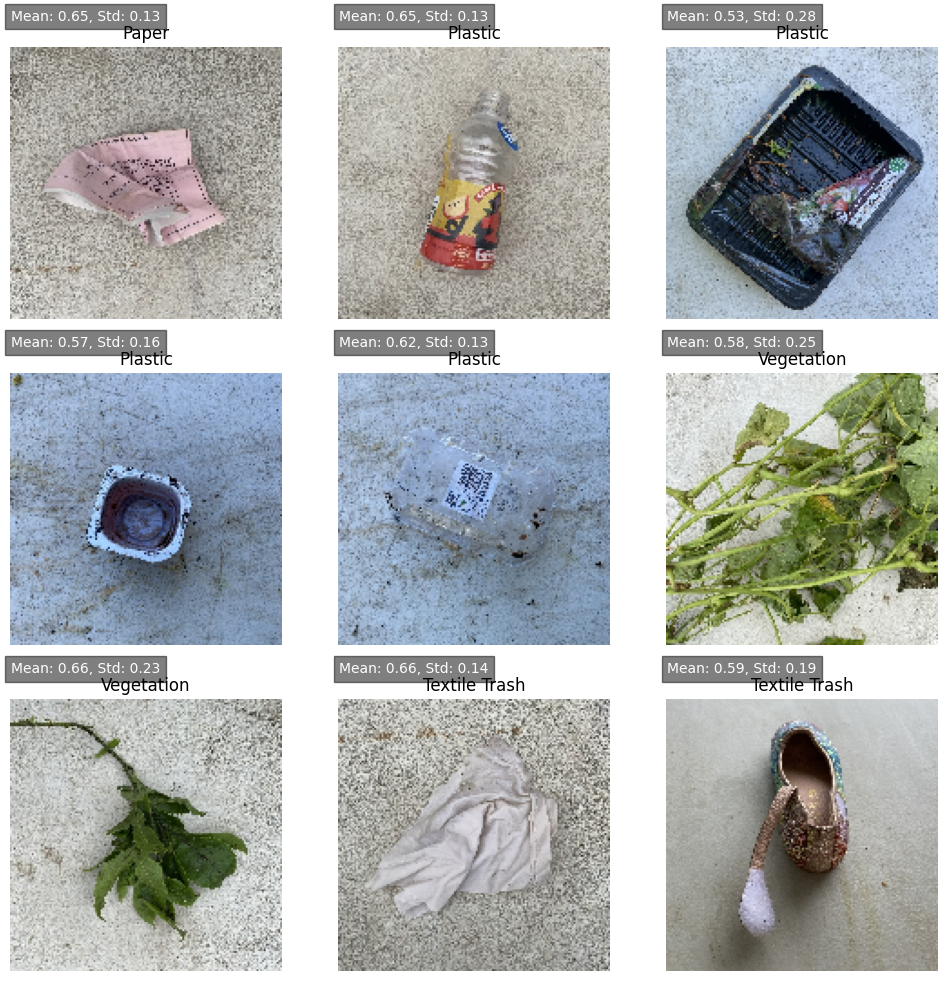

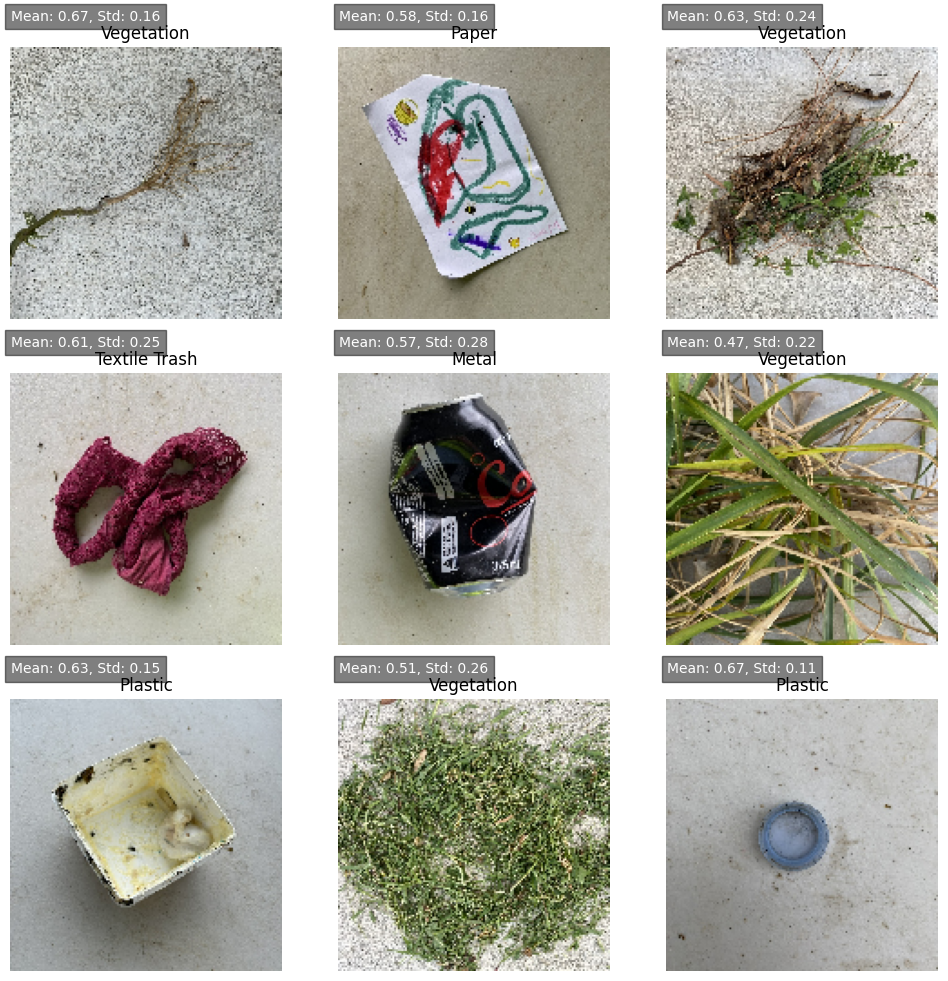

In [ ]:
categories = train_generator.class_indices
output_dir = "/content/drive/MyDrive/Dataset HOA_9.1/SAVED"

if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def save_images(generator, num_images=9):
    for i in range(num_images):
        batch = generator.next()
        image = batch[0][0]
        label_index = batch[1][0].argmax()
        label = list(categories.keys())[list(categories.values()).index(label_index)]
        mean_pixel_value = np.mean(batch[0][0])
        std_pixel_value = np.std(batch[0][0])

        # Random flips to the displayed image
        flipped_image = np.fliplr(image) if np.random.rand() < 0.5 else np.flipud(image)

        filename = f"{label}_{i}.png"
        filepath = os.path.join(output_dir, filename)
        plt.imsave(filepath, flipped_image)

# Save augmented images for training
save_images(train_generator)

# Save augmented images for validation
save_images(validation_generator)

plot_images(train_generator)
plot_images(validation_generator)

OUTPUT:

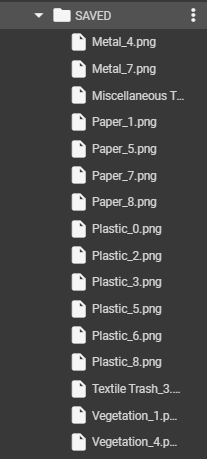


# Task 7 Develop a test harness to develop a robust evaluation of a model and establish a baseline of performance for a classification task

In [ ]:
# Define image dimensions and batch size
img_width, img_height = 150, 150
batch_size = 32

# Create data generators for training, validation, and testing with image augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    horizontal_flip=True,
    validation_split=0.2
)

train_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

# Build the CNN model
model2 = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(img_width, img_height, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(train_generator.num_classes, activation='softmax')
])

# Compile the model
model2.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
history = model2.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // batch_size
)

# Evaluate the model on the test data
test_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation',
    shuffle=False  # Ensure the order of predictions matches the order of true labels
)

test_loss, test_accuracy = model2.evaluate(validation_generator)
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

Found 2425 images belonging to 9 classes.
Found 605 images belonging to 9 classes.
Epoch 1/10
75/75 [==============================] - 175s 2s/step - loss: 1.6495 - accuracy: 0.3920 - val_loss: 1.4348 - val_accuracy: 0.4497
Epoch 2/10
75/75 [==============================] - 169s 2s/step - loss: 1.2169 - accuracy: 0.5361 - val_loss: 1.4005 - val_accuracy: 0.4618
Epoch 3/10
75/75 [==============================] - 167s 2s/step - loss: 1.0875 - accuracy: 0.5888 - val_loss: 1.3456 - val_accuracy: 0.4913
Epoch 4/10
75/75 [==============================] - 169s 2s/step - loss: 0.9693 - accuracy: 0.6298 - val_loss: 1.3092 - val_accuracy: 0.5122
Epoch 5/10
75/75 [==============================] - 175s 2s/step - loss: 0.8586 - accuracy: 0.6740 - val_loss: 1.2986 - val_accuracy: 0.5208
Epoch 6/10
75/75 [==============================] - 181s 2s/step - loss: 0.8562 - accuracy: 0.6807 - val_loss: 1.4915 - val_accuracy: 0.4531
Epoch 7/10
75/75 [==============================] - 179s 2s/step - loss

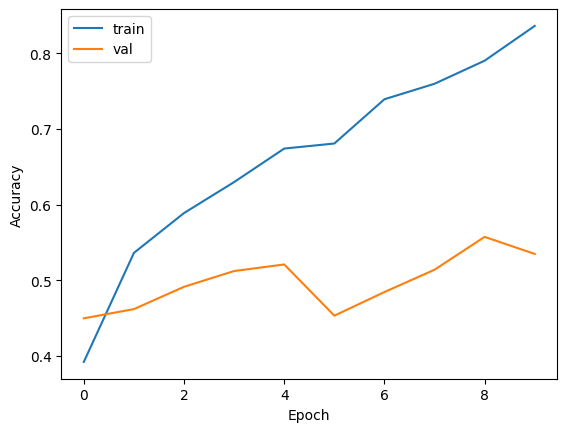

In [ ]:
# Plot training history
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='val')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Task 8 : Explore extensions to a baseline model to improve learning and model capacity.

In [13]:
# Define image dimensions and batch size
img_width, img_height = 170, 170
batch_size = 32

train_dir = '/content/drive/MyDrive/Dataset HOA_9.1/train'
val_dir = '/content/drive/MyDrive/Dataset HOA_9.1/val'
class_names = sorted(os.listdir(train_dir))
num_classes = len(class_names)


# Create data generators for training, validation, and testing with image augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    horizontal_flip=True,
    validation_split=0.2
)

train_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

# Build the CNN model
model3 = Sequential([
    Conv2D(32, (3, 3), input_shape=(img_width, img_height, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(230, activation='relu'),
    Dropout(0.5),
    Dense(9, activation='relu'),
    Dropout(0.5),
    Dense(train_generator.num_classes, activation='softmax')
])

# Compile the model
model3.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
history = model3.fit(train_generator, epochs=10, validation_data=validation_generator)


# Evaluate the model
_, test_acc = model3.evaluate(validation_generator)
print('Test accuracy:', test_acc)



Found 2434 images belonging to 9 classes.
Found 605 images belonging to 9 classes.
Epoch 1/10
77/77 [==============================] - 208s 3s/step - loss: 2.2198 - accuracy: 0.2391 - val_loss: 1.8724 - val_accuracy: 0.3355
Epoch 2/10
77/77 [==============================] - 183s 2s/step - loss: 1.9791 - accuracy: 0.2321 - val_loss: 1.8311 - val_accuracy: 0.2463
Epoch 3/10
77/77 [==============================] - 180s 2s/step - loss: 1.9239 - accuracy: 0.2399 - val_loss: 1.7545 - val_accuracy: 0.2843
Epoch 4/10
77/77 [==============================] - 170s 2s/step - loss: 1.8538 - accuracy: 0.2888 - val_loss: 1.7308 - val_accuracy: 0.2727
Epoch 5/10
77/77 [==============================] - 193s 3s/step - loss: 1.7859 - accuracy: 0.2827 - val_loss: 1.6553 - val_accuracy: 0.3190
Epoch 6/10
77/77 [==============================] - 175s 2s/step - loss: 1.7295 - accuracy: 0.3168 - val_loss: 1.5667 - val_accuracy: 0.4017
Epoch 7/10
77/77 [==============================] - 181s 2s/step - loss

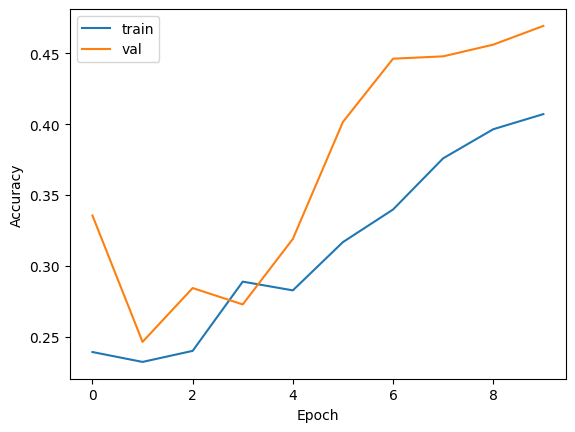

In [14]:
# Plot training history
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='val')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Task 9 : Develop a finalized model, evaluate the performance of the final model, and use it to make predictions on new images.

In [98]:
from joblib import dump, load

# Save the pipeline to a file
dump(model, '/content/drive/MyDrive/Dataset HOA_9.1/final_model')

['/content/drive/MyDrive/Dataset HOA_9.1/final_model']

In [36]:
# Load the saved model
loaded_model = load('/content/drive/MyDrive/Dataset HOA_9.1/final_model')

# Function to preprocess a single image
def preprocess_image(image_path, target_size=(256, 256)):
    img = cv2.imread(image_path)
    if img is None:
        return None
    img = cv2.resize(img, target_size)
    img_flat = img.reshape(1, -1)
    return img, img_flat

Testing sample image for category: Paper
1/1 [==============================] - 0s 185ms/step


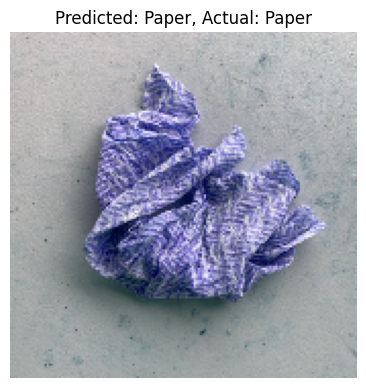

Testing sample image for category: Vegetation
1/1 [==============================] - 0s 64ms/step


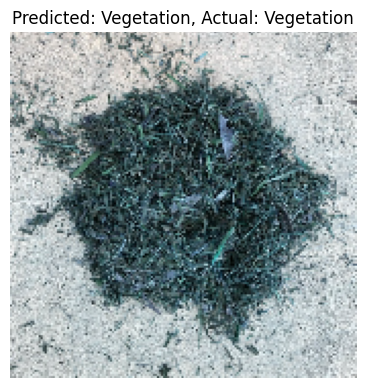

Testing sample image for category: Miscellaneous Trash
1/1 [==============================] - 0s 47ms/step


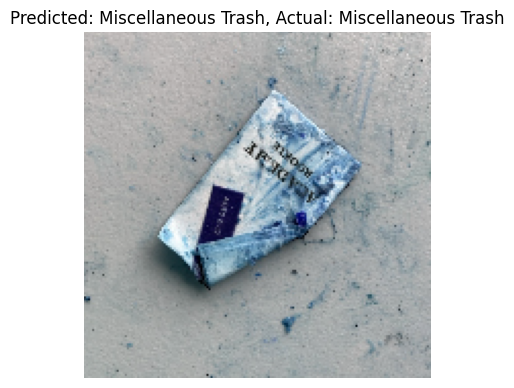

Testing sample image for category: Plastic
1/1 [==============================] - 0s 47ms/step


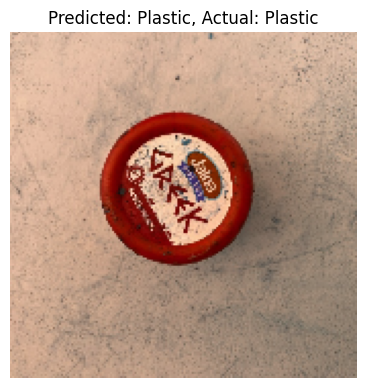

Testing sample image for category: Cardboard
1/1 [==============================] - 0s 46ms/step


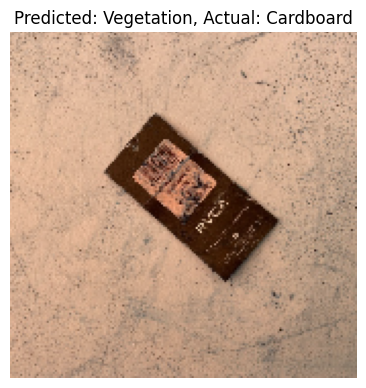

Testing sample image for category: Food Organics
1/1 [==============================] - 0s 49ms/step


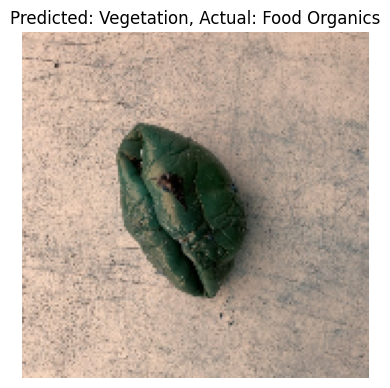

Testing sample image for category: Glass
1/1 [==============================] - 0s 42ms/step


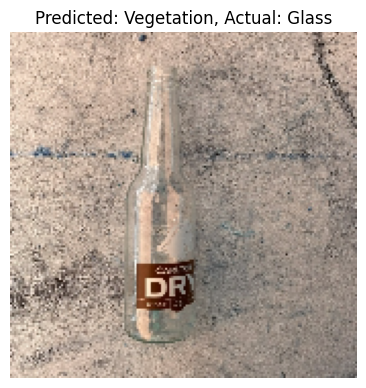

Testing sample image for category: Metal
1/1 [==============================] - 0s 41ms/step


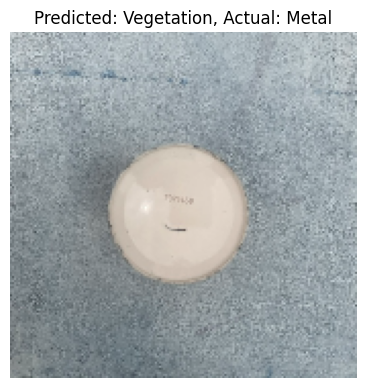

Testing sample image for category: Textile Trash
1/1 [==============================] - 0s 48ms/step


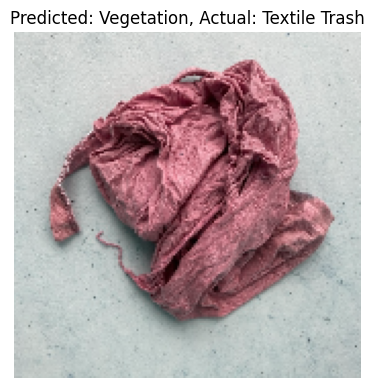

In [96]:
def preprocess_image(image_path):
    # Load the image using OpenCV
    img = cv2.imread(image_path)

    if img is None:
        return None, None

    # Resize the image to match the model's input shape (150x150)
    img_resized = cv2.resize(img, (170, 170))

    # Expand dimensions to create a batch of 1
    img_expanded = img_resized[np.newaxis, ...]

    return img_resized, img_expanded

# Test a sample image for each class
sample_image_paths = {
       'Paper': '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste/Paper/1_randompaper.jpg',
       'Vegetation': '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste/Vegetation/Vegetation_96.jpg',
       'Miscellaneous Trash': '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste/Miscellaneous Trash/Miscellaneous Trash_11.jpg',
       'Plastic': '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste/Plastic/2_randomplastic.jpg',
       'Cardboard': '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste/Cardboard/Cardboard_95.jpg',
       'Food Organics': '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste/Food Organics/Food Organics_78.jpg',
       'Glass': '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste/Glass/Glass_40.jpg',
       'Metal': '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste/Metal/Metal_100.jpg',
       'Textile Trash': '/content/drive/MyDrive/Dataset HOA_9.1/RealWaste/Textile Trash/Textile Trash_301.jpg',
}

for cls, image_path in sample_image_paths.items():
    print(f"Testing sample image for category: {cls}")
    img, img_expanded = preprocess_image(image_path)
    if img is None:
        print(f"Unable to load image: {image_path}")
        continue

    # Make predictions
    predicted_class = loaded_model.predict(img_expanded)[0]
    predicted_class_scalar = np.argmax(predicted_class)  # Extract the integer scalar

    # Display image with predicted and actual labels
    plt.figure(figsize=(4.5, 4.5))
    plt.imshow(img)
    plt.title(f"Predicted: {class_names[predicted_class_scalar]}, Actual: {cls}")  # Use the extracted scalar
    plt.axis('off')
    plt.show()

Observation:

As we can see we have 9 outputs and out of 9 my model has predicted only 4 category correct. The first 4 category was predicted correct whilst the other are not predicted correctly.

# Summary and Conclusion

Summary:

So for my summary, what I did first is I find a Image dataset that is a Classification type, Then I found the RealWaste dataset it is also a multi class classification dataset. Next thing I did was I downloaded the dataset since it is not available for importing to python, after downloading I uploaded the dataset into my Gdrive since that will be my means of importing my daataset to the colab. At first it was really hard on finding a dataset that is very organized since in the UCI there are only 12 daatasets images. It was also a very big dataset so uploading the dataset into Gdrives was quite time consuming but nontheless it was uploaded successfully. Upon doing this Hands On activity it was really hard for me to do since the module provided was abit complex and the way they imported the dataset were built-in in keras so technically it is quite far from the way we have to import our dataset. Nonetheless it was still doable.




Conclusion:

So for my conclusion for this Hands on Activity, firstly the datasets were in huge file size so it was time consuming for me to download and upload it in Gdrive, but nontheless I was still able to import it in Gdrive. Then upon doing the task for this activty I find it really hard at first on how I should be able to split my dataset into training and Validation, thanfully I was able to do it, after that I proceeded on doing the tasks that we were asked to do. After doing the some of the task, I encountered a huge problem in doing the model for this Activity, well technically it is not really that big of a deal but, it was very time consuming since I have a lot of pictures to train it is very expected for me that it'll take a while but suprisingly it took 48 mins to run with only 10 epochs. But after training it was smooth sailing again in doing the random flips, shifts and rotation. Then again after that I need to train a model once again so as expected it was very time consuming to do. But nonetheless all I had to do was wait. Although I encountered some problems like, I didnt define a function in the model compile, in the end after the epoch training when I had to evaluate it has an error due to the fact I forgot to define the function, so I had to retrain the model again for another 48mins which is very frustrating and time consuming. For the Task 9, we can see I did a mock test I got all different pictures from google to do the predictions on my model, suprisingly out of 9 classes it only predicted 4 out of 9 classes. I have learned alot on how I should do the spliting of data and also choosing the most optimal dataset would probably help my accuracy increase.